# Milestone 3: GranADA

## 1. Imports

We start by importing all the packages needed

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import plotly
import os
import json
import requests

import matplotlib.pyplot as plt
import plotly.graph_objects as go
from helpers import *

## 2. Datasets
Download the "All Data" folders for each category in "Bulk Downloads", then place folders in a "__data/__" folder for this notebook.

* df_prod: http://www.fao.org/faostat/en/#data/QC
* df_value: http://www.fao.org/faostat/en/#data/QV
* df_trade: http://www.fao.org/faostat/en/#data/TM
* df_pop: https://population.un.org/wpp/

Note: Population data was extracted from "Estimates" for [1993:2016], tags were manually modified to fit FAO style. Modified CSV file must be given.

## 3. Data Exploration

We start by identifying common products in our datasets. Many of the definitions of the datasets herunder are taken from the FAO's website, with some trimming and modifications from us.

### 3.1 Loading the data

We start by loading the data into pandas dataframes

In [2]:
df_prod = pd.read_csv("data/Production_Crops_E_All_Data/Production_Crops_E_All_Data.csv",
                      encoding="unicode_escape")
df_value = pd.read_csv("data/Value_of_Production_E_All_Data/Value_of_Production_E_All_Data.csv",
                       encoding="unicode_escape")
df_trade = pd.read_csv('data/Trade_DetailedTradeMatrix_E_All_Data/Trade_DetailedTradeMatrix_E_All_Data.csv',
                       encoding="unicode_escape")

df_pop = pd.read_csv("data/Population_table_trimmed.csv",
                     encoding="unicode_escape")
df_pop = df_pop.sort_values(by=['Area'])
df_pop.reset_index(drop=True,inplace=True)

/Users/Niels/anaconda3/envs/ada/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3058: DtypeWarning:

Columns (10,12,14,16,18,20,22,24,26,28,30,32,34,36,38,40,42,44,46,48,50,52,54,56,58,60,62,64,66,68,70,72) have mixed types. Specify dtype option on import or set low_memory=False.



### 3.2 Dataset Descriptions

#### Production Dataset

The production dataset contains 180 products (the item row in the dataset) and 258 areas (countries and regions), with the following possible values

* Production Quantity and Seed \[tonnes\] 
* Area harvested \[hectares\]
* Yield \[tonnes per hectare\]

In [3]:
print(f'Number of products: {len(df_prod["Item"].value_counts())}')
print(f'Number of areas: {len(df_prod["Area"].value_counts())}')
df_prod.head()

Number of products: 180
Number of areas: 258


,Area Code,Area,Item Code,Item,Element Code,Element,Unit,Y1961,Y1961F,Y1962,...,Y2013,Y2013F,Y2014,Y2014F,Y2015,Y2015F,Y2016,Y2016F,Y2017,Y2017F
0,2,Afghanistan,221,"Almonds, with shell",5312,Area harvested,ha,NaN,NaN,NaN,...,14114.0,NaN,13703.0,NaN,14676.0,NaN,19481.0,NaN,19793.0,NaN
1,2,Afghanistan,221,"Almonds, with shell",5419,Yield,hg/ha,NaN,NaN,NaN,...,29910.0,Fc,19996.0,Fc,16521.0,Fc,16859.0,Fc,13788.0,Fc
2,2,Afghanistan,221,"Almonds, with shell",5510,Production,tonnes,NaN,NaN,NaN,...,42215.0,NaN,27400.0,NaN,24246.0,NaN,32843.0,NaN,27291.0,NaN
3,2,Afghanistan,711,"Anise, badian, fennel, coriander",5312,Area harvested,ha,NaN,M,NaN,...,18500.0,F,30000.0,F,25000.0,F,26019.0,Im,28873.0,Im
4,2,Afghanistan,711,"Anise, badian, fennel, coriander",5419,Yield,hg/ha,NaN,NaN,NaN,...,6757.0,Fc,7167.0,Fc,7200.0,Fc,6923.0,Fc,6830.0,Fc


#### Value Dataset

There are 222 products and 261 areas in this dataset. Value of gross production is provided in both current and constant terms and is expressed in US dollars and Standard Local Currency (SLC). The current value of production measures value in the prices relating to the period being measured. Thus, it represents the market value of food and agricultural products at the time they were produced.

Expressing data series in one uniform currency is useful because it avoids the influence of revaluation in local currency, if any, on value of production. The following elements are present in the dataset.

* Gross Production Value (constant 2004-2006 1000 International USD)
* Gross Production Value (constant 2004-2006 million Standard Local Currency)
* Gross Production Value (constant 2004-2006 million USD)
* Gross Production Value (current million Standard Local Currency)
* Gross Production Value (current million USD)
* Net Production Value (constant 2004-2006 1000 International USD)

In [4]:
print(f'Number of products: {len(df_value["Item"].value_counts())}')
print(f'Number of areas: {len(df_value["Area"].value_counts())}')
df_value.head()

Number of products: 222
Number of areas: 261


,Area Code,Area,Item Code,Item,Element Code,Element,Unit,Y1961,Y1961F,Y1962,...,Y2012,Y2012F,Y2013,Y2013F,Y2014,Y2014F,Y2015,Y2015F,Y2016,Y2016F
0,2,Afghanistan,221,"Almonds, with shell",152,Gross Production Value (constant 2004-2006 100...,1000 Int. $,NaN,NaN,NaN,...,182960.078000,Fc,124575.156335,Fc,80856.550600,Fc,71549.194374,Fc,96918.674867,Fc
1,2,Afghanistan,221,"Almonds, with shell",154,Net Production Value (constant 2004-2006 1000 I$),1000 Int. $,NaN,NaN,NaN,...,182960.078000,Fc,124575.156335,Fc,80856.550600,Fc,71549.194374,Fc,96918.674867,Fc
2,2,Afghanistan,221,"Almonds, with shell",56,Gross Production Value (current million SLC),SLC,NaN,NaN,NaN,...,14911.000000,Fc,9230.459191,Fc,5563.109132,Fc,4824.773367,Fc,6050.024466,Fc
3,2,Afghanistan,221,"Almonds, with shell",55,Gross Production Value (constant 2004-2006 mil...,SLC,NaN,NaN,NaN,...,6460.468889,Fc,4398.849906,Fc,2855.110444,Fc,2526.460140,Fc,3422.277092,Fc
4,2,Afghanistan,711,"Anise, badian, fennel, coriander",152,Gross Production Value (constant 2004-2006 100...,1000 Int. $,NaN,NaN,NaN,...,69090.200000,Fc,69090.200000,Fc,73114.852434,Fc,79457.968291,Fc,77478.699955,Fc


#### Trade Dataset

Export values are reported as FOB (free on board — that is, the value of the goods plus the value of the services performed to deliver the goods to the border of the exporting country).

Value of agricultural imports: Value of agricultural imports are expressed in thousand US dollars in the FAOSTAT database. Import values are reported as CIF (cost insurance and freight — that is, the value of the goods, plus the value of the services performed to deliver goods to the border of the exporting country, plus the value of the services performed to deliver the good from the border of the exporting country to the border of the importing country).

Quantity of food and agricultural imports: Import quantity represents the physical quantity of the products imported for domestic consumption or processing shipped into a country. It includes re-imports.

In [5]:
print(f'Number of products: {len(df_trade["Item"].value_counts())}')
print(f'Number of areas partner: {len(df_trade["Partner Countries"].value_counts())}')
print(f'Number of areas reporting: {len(df_trade["Reporter Countries"].value_counts())}')
df_trade.head()

Number of products: 424
Number of areas partner: 255
Number of areas reporting: 184


,Reporter Country Code,Reporter Countries,Partner Country Code,Partner Countries,Item Code,Item,Element Code,Element,Unit,Y1986,...,Y2013,Y2013F,Y2014,Y2014F,Y2015,Y2015F,Y2016,Y2016F,Y2017,Y2017F
0,2,Afghanistan,4,Algeria,230,"Cashew nuts, shelled",5910,Export Quantity,tonnes,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,3.0,*,NaN,NaN
1,2,Afghanistan,4,Algeria,230,"Cashew nuts, shelled",5922,Export Value,1000 US$,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,23.0,*,NaN,NaN
2,2,Afghanistan,4,Algeria,1293,Crude materials,5922,Export Value,1000 US$,NaN,...,NaN,NaN,NaN,NaN,1.0,*,1.0,*,5.0,R
3,2,Afghanistan,4,Algeria,561,Raisins,5910,Export Quantity,tonnes,NaN,...,NaN,NaN,12.0,*,NaN,NaN,NaN,NaN,NaN,NaN
4,2,Afghanistan,4,Algeria,561,Raisins,5922,Export Value,1000 US$,NaN,...,NaN,NaN,27.0,*,NaN,NaN,NaN,NaN,NaN,NaN


### 3.3 Adjusting Units of Interest

We start by removing rows that aren't in the 1000 USD currency unit from the trade matrix. We only want to keep production values for (area, item) pairs where we have data on the Gross and Net Production value. Two methods to manipulate data were tested. Ultimately using "sets" and redefining the dataframe was much faster.

We separate the value datasets into datasets containing only the net or gross production value.

In [6]:
US_gross = df_value.Element == "Gross Production Value (constant 2004-2006 1000 I$)"
US_net = df_value.Element == "Net Production Value (constant 2004-2006 1000 I$)"

df_value_g = df_value[US_gross]
df_value_n = df_value[US_net]
df_value = df_value[US_net|US_gross]

print(f'Gross Production Value rows: {len(df_value_g.Element)}')
print(f'Net Production Value rows  : {len(df_value_n.Element)}')
print(f'Total Production Value rows: {len(df_value.Element)}')

Gross Production Value rows: 20346
Net Production Value rows  : 20260
Total Production Value rows: 40606


In [7]:
# Obtain all (area, item) pairs for which we have Gross Production Value
AI_value_ind_g = df_value_g['Area'].astype(str) + df_value_g['Item']
AI_value_g = set(AI_value_ind_g.unique())

# Obtain all (area, item) pairs for which we have Net Production Value
AI_value_ind_n = df_value_n['Area'].astype(str) + df_value_n['Item']
AI_value_n = set(AI_value_ind_n.unique())

AI_g = AI_value_g - AI_value_n
AI_n = AI_value_n - AI_value_g

df_value = df_value.drop(AI_value_ind_g[[AI in AI_g for AI in AI_value_ind_g]].index)
df_value.Element.value_counts()

Gross Production Value (constant 2004-2006 1000 I$)    20260
Net Production Value (constant 2004-2006 1000 I$)      20260
Name: Element, dtype: int64

### 3.4 Adjusting Years of Interest

A lot of data is missing for the years before 1993, and the value dataset only contains data up to 2016. Hence we limit or data to the years 1993-2016.

Additionaly, in the values for both "not reported" and "zero" are NaN. The flags in each dataset help specify if the NaN value represents zero or is actually missing.

The reduce the size of the dataframes, a function was written to remove unused columns (such as unused years, and non human readable tags). This function also replaces NaN values by zero when the value is meant to be zero.

In [8]:
def remove_years(df, year_min=[1961,1993], year_max=[2017,2020]):   
    """
    Cleans data matrix by FAO-code columns, and FAO-flag columns. 
    Additionaly removes undesired years from matrices.
    
    :param df: pd.DataFrame The dataframe containing the import, export, production, or value data.
    :param year_min: range of minimum years to be removed [1981,1993], 1993 excluded.
    :param year_min: range of maximum years to be removed [2017,2020], 2020 excluded.
    :return: pd.DataFrame containing trimmed down data.
    """
    #Flags NaN mean "official data". Flag M means missing value. Therefore, [NaN,NaN] in [Y#,Y#F] means zero.
    #Note: for "production value" dataset, Flags NaN is not explicitely reported as the "official data"
    for year in range(year_min[1],year_max[0]):
        yi="Y"+str(year)
        yf="Y"+str(year)+"F"
        df.loc[df[yi].isna() & df[yf].isna(), [yi]] = 0.0
    
    #Keep human readable columns not containign "Code" and "Y&F"
    df = df.drop(columns=[label for label in df.columns if 'Y' and 'F' in label])
    df = df.drop(columns=[label for label in df.columns if 'Code' in label])
    
    #Remove undesired years
    yr_list_min = ["Y"+str(year) for year in range(year_min[0],year_min[1])]
    yr_list_max = ["Y"+str(year) for year in range(year_max[0],year_max[1])]
    df = df.drop(columns=[year for year in df.columns if year in yr_list_min])
    df = df.drop(columns=[year for year in df.columns if year in yr_list_max])
    return df

df_prod = remove_years(df_prod)
df_value = remove_years(df_value)
df_trade = remove_years(df_trade)

### 3.5 Adjusting Countries

More countries are present in the country list than number of countries in the world. We noticed that some countries that no longer exist appeared (i.e. "USSR"). These were left in, in case data gaps needed to be explained. To remove specific countries, they can later be removed from the overlap set.

We start by checking, if some countries are partners but never reporters in the trade matrix.

In [9]:
reporter_set = set(df_trade["Reporter Countries"].unique())
partner_set = set(df_trade["Partner Countries"].unique())

print(f" Only in reporter countries:\n {reporter_set.difference(partner_set)} \n")
print(f" Only in partner countries:\n {partner_set.difference(reporter_set)} \n")

 Only in reporter countries:
 set() 

 Only in partner countries:
 {'Unspecified Area', 'Canton and Enderbury Islands', 'British Indian Ocean Territory', 'Antarctica', 'American Samoa', 'Liberia', 'Tokelau', 'Guam', 'South Georgia and the South Sandwich Islands', 'Tajikistan', 'Wake Island', 'Equatorial Guinea', 'Turkmenistan', 'Cayman Islands', 'Samoa', 'Neutral Zone', 'Mayotte', 'Uzbekistan', 'Saint Pierre and Miquelon', 'Pacific Islands Trust Territory', 'Western Sahara', 'Haiti', 'French Southern and Antarctic Territories', 'Norfolk Island', 'Wallis and Futuna Islands', 'Christmas Island', 'Viet Nam', 'Somalia', 'Lesotho', 'Northern Mariana Islands', 'Midway Island', 'Micronesia (Federated States of)', 'Anguilla', 'Eritrea', 'Svalbard and Jan Mayen Islands', 'Liechtenstein', 'Johnston Island', 'Bouvet Island', 'San Marino', 'Marshall Islands', 'Palestine', 'Pitcairn Islands', 'Guinea-Bissau', 'Niue', 'Saint Helena, Ascension and Tristan da Cunha', 'Iraq', 'Sudan', 'Chad', "Lao Peop

We can note that many of these "countries" are either small territories where their reporter country would generally the country they are attached to (British Indian Ocean Territory -> United Kingdom), aren't actual countries (Antarctica) or are at war (South Sudan). 

We check how well the different countries line up between the different datasets.

In [10]:
country_p = set(df_prod.Area.unique())
country_v = set(df_value.Area.unique())
country_t = set(df_trade["Partner Countries"].unique())

country_pv = country_p.intersection(country_v)
country_pt = country_p.intersection(country_t)

country_all = country_pv.intersection(country_pt)

print(f"Prod. country list length:      {len(country_p)}")
print(f"Value country list length:      {len(country_v)}")
print(f"PV Joined country list length:  {len(country_pv)}")
print(f"Trade country list length:      {len(country_t)}")
print(f"PT Joined country list length:  {len(country_pt)}\n")
print(f"All Joined country list length: {len(country_all)}")

Prod. country list length:      258
Value country list length:      261
PV Joined country list length:  258
Trade country list length:      255
PT Joined country list length:  221

All Joined country list length: 221


We end up with 221 that are in all datasets. We only keep the countries for which we also have population data.

In [11]:
A_pop_ind = df_pop['Area']
A_pop = set(A_pop_ind.unique())

print("In population matrix only:\n", A_pop - country_all)
print("\nIn production matrix only:\n", country_all - A_pop)

country_all = country_all.intersection(A_pop)

# Verifying no undesired "Territories" remain in list
country_not = set(["World","Asia","Net Food Importing Developing Countries","Americas",\
                 "Low Income Food Deficit Countries","Africa","Land Locked Developing Countries",\
                 "South America","Eastern Asia","Least Developed Countries","Europe","European Union",\
                 "Central America","Southern Europe","Oceania","China","Western Asia","Southern Asia",\
                 "Eastern Africa","Northern Africa","Eastern Europe","South-Eastern Asia","Northern America",\
                 "Small Island Developing States","Western Europe","Central Asia","Western Africa","Middle Africa",\
                 "Caribbean","Southern Africa"])

print(f"\nNone-countries in country list:\n {country_all.intersection(country_not)} \n")

In population matrix only:
 {'Channel Islands', 'North Macedonia', 'Mayotte', 'Saint Barthélemy', 'Aruba', 'Northern Mariana Islands', 'Anguilla', 'Isle of Man', 'Greenland', 'San Marino', 'Western Africa', 'Bonaire, Sint Eustatius and Saba', 'Curaçao', 'Monaco', 'Saint Martin (French part)', 'Gibraltar', 'Andorra', 'Palau', 'Sint Maarten (Dutch part)', 'Falkland Islands (Malvinas)', 'Turks and Caicos Islands', 'Holy See', 'State of Palestine'}

In production matrix only:
 {'Yugoslav SFR', 'USSR', 'Belgium-Luxembourg', 'Ethiopia PDR', 'Serbia and Montenegro', 'Czechoslovakia', 'Sudan (former)', 'Pacific Islands Trust Territory'}

None-countries in country list:
 set() 



We then remove countries that aren't found in all sets.

In [12]:
df_prod = df_prod[[country in country_all for country in df_prod["Area"]]]
df_value = df_value[[country in country_all for country in df_value["Area"]]]
df_trade = df_trade[[country in country_all for country in df_trade["Partner Countries"]]]
df_trade = df_trade[[country in country_all for country in df_trade["Reporter Countries"]]]
df_pop = df_pop[[country in country_all for country in df_pop["Area"]]]

We then verify if any additonal differences between datasets realting to area tags must be resolved.

In [13]:
print(f'Items produced per country:\n{df_prod["Area"].value_counts()}\n\n')
print(f'Items values per country:\n{df_value["Area"].value_counts()}\n\n')

Items produced per country:
China, mainland                                 395
Mexico                                          374
Spain                                           349
Peru                                            331
Turkey                                          322
                                               ... 
Faroe Islands                                     6
United States Virgin Islands                      5
China, Macao SAR                                  3
Liechtenstein                                     2
Saint Helena, Ascension and Tristan da Cunha      2
Name: Area, Length: 213, dtype: int64


Items values per country:
China, mainland                                 310
Mexico                                          280
Spain                                           272
Turkey                                          264
Morocco                                         252
                                               ... 
Western Sahara        

The production matrix and value matrix do not have data that correspond to eachother. As such, data without its "production:value" pair is removed.

In [14]:
AI_prod_ind = df_prod['Area'].astype(str) + df_prod['Item']
AI_prod = set(AI_prod_ind.unique())

AI_value_ind = df_value['Area'].astype(str) + df_value['Item']
AI_value = set(AI_value_ind.unique())

AI_all = AI_prod.intersection(AI_value)

print(f"Prod Area/Item pair length:  {len(AI_prod)}")
print(f"Value Area/Item pair length: {len(AI_value)}")
print(f"Area/Item intersect length:  {len(AI_all)}")

df_prod = df_prod[[AI in AI_all for AI in AI_prod_ind]]
df_value = df_value[[AI in AI_all for AI in AI_value_ind]]

Prod Area/Item pair length:  11979
Value Area/Item pair length: 14393
Area/Item intersect length:  10101


In [15]:
print(f'Number of trades as a reporter:\n{df_trade["Reporter Countries"].value_counts()}\n\n')
print(f'Number of trades as a partner:\n{df_trade["Partner Countries"].value_counts()}\n\n')
print(f'Difference\n: {df_trade["Reporter Countries"].value_counts() - df_trade["Partner Countries"].value_counts()}')

Number of trades as a reporter:
Netherlands                 122185
France                      114931
Germany                     110131
United States of America    109423
United Kingdom              102120
                             ...  
Sao Tome and Principe         3208
French Guiana                 3112
Bhutan                        2160
Cook Islands                  1976
Tuvalu                        1556
Name: Reporter Countries, Length: 174, dtype: int64


Number of trades as a partner:
United States of America        122076
France                          113378
Germany                         106747
Netherlands                     104205
United Kingdom                  103736
                                 ...  
South Sudan                       1239
United States Virgin Islands      1163
Liechtenstein                      820
Tokelau                            633
Western Sahara                     177
Name: Partner Countries, Length: 213, dtype: int64


Difference
: Afg

For the trade data, we can note quite a bit of discrepency in the data. Sadly, there isn't much to do about it. As described on the FAO  website, these trades can arise from quite a few scenarios. From ships that sinks midway through a journey, and an export is reported but not an import, to three country trades where different countries report different importing and exporting values.





### 3.6 Adjusting Items

We now want to keep only items present in all datasets.

In [16]:
item_p = set(df_prod.Item.unique())
item_v = set(df_value.Item.unique())
item_t = set(df_trade.Item.unique())
item_pt = item_p.intersection(item_t)
item_all = item_pt.intersection(item_v)

print(f" Production item list length: {len(item_p)}")
print(f" Value item list length:      {len(item_v)}")
print(f" Trade item list length:      {len(item_t)}")
print(f" PT Joined list length:       {len(item_pt)}")
print(f" All item list length:        {len(item_all)}")

#Selecting values that only contain overlap items.
df_prod = df_prod[[item in item_all for item in df_prod["Item"]]]
df_value = df_value[[item in item_all for item in df_value["Item"]]]
df_trade = df_trade[[item in item_all for item in df_trade["Item"]]]

 Production item list length: 161
 Value item list length:      161
 Trade item list length:      423
 PT Joined list length:       120
 All item list length:        120


## 3.7 Exploring Global Trade Trends

### 3.7.1 Setup

We start by importing the trade data from the pickle file, and define a plotting function that will help us explore global trade.

In [17]:
def plot_trade(s1, s2, label):
    plt.figure(figsize=(15,5))
    plt.xlabel('Year')

    ax1 = s1.plot(label=label+' Weights')
    ax2 = s2.plot(label=label+' Values', secondary_y=True)

    ax1.set_ylabel('tonnes')
    ax2.set_ylabel('1000 US$')

    h1, l1 = ax1.get_legend_handles_labels()
    h2, l2 = ax2.get_legend_handles_labels()

    plt.legend(h1+h2, l1+l2, loc=2)
    plt.show()

In [18]:
df_trade.head()

,Reporter Countries,Partner Countries,Item,Element,Unit,Y1993,Y1994,Y1995,Y1996,Y1997,...,Y2007,Y2008,Y2009,Y2010,Y2011,Y2012,Y2013,Y2014,Y2015,Y2016
11,Afghanistan,Argentina,Maize,Import Quantity,tonnes,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
12,Afghanistan,Argentina,Maize,Import Value,1000 US$,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
25,Afghanistan,Australia,"Anise, badian, fennel, coriander",Export Quantity,tonnes,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
26,Afghanistan,Australia,"Anise, badian, fennel, coriander",Export Value,1000 US$,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
27,Afghanistan,Australia,Apricots,Export Quantity,tonnes,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0


### 3.7.2 Global Trade Volume

We start by looking at the difference in trade volume by looking at the change in imports and exports by weight (in tonnes) and by value (in 1000 US$, adjusted to 2014-2016 value)

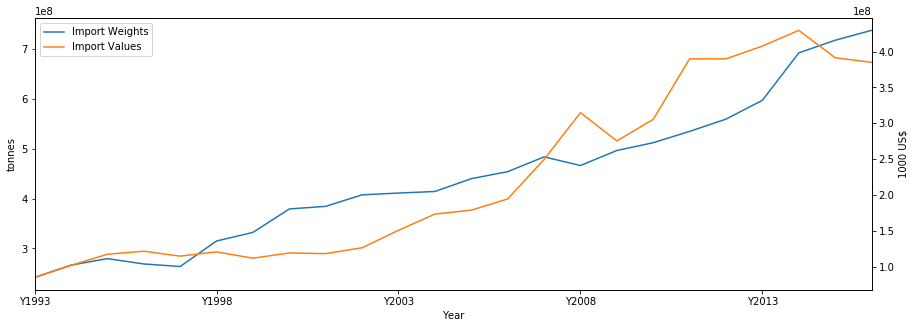

In [19]:
import_w = df_trade[(df_trade['Element'] == 'Import Quantity')]\
    [[f'Y{label}' for label in range(1993, 2017)]].sum(axis=0)
import_v = df_trade[(df_trade['Element'] == 'Import Value')]\
    [[f'Y{label}' for label in range(1993, 2017)]].sum(axis=0)

plot_trade(import_w, import_v, 'Import')

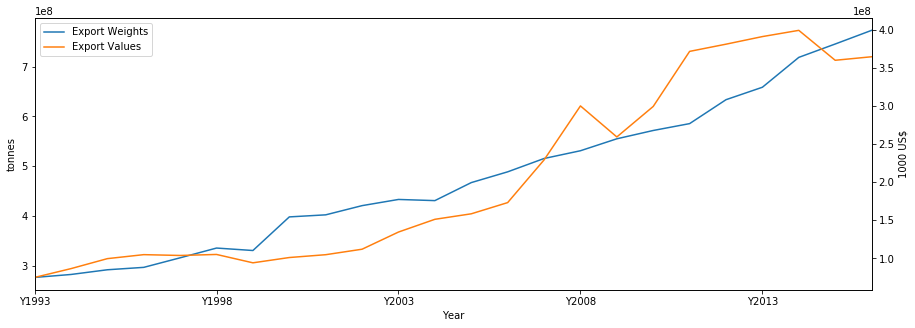

In [20]:
export_w = df_trade[(df_trade['Element'] == 'Export Quantity')]\
    [[f'Y{label}' for label in range(1993, 2017)]].sum(axis=0)
export_v = df_trade[(df_trade['Element'] == 'Export Value')]\
    [[f'Y{label}' for label in range(1993, 2017)]].sum(axis=0)

plot_trade(export_w, export_v, 'Export')

We can see some slight disparities between imports and exports. This arises from multiple issues. Let's see the difference.

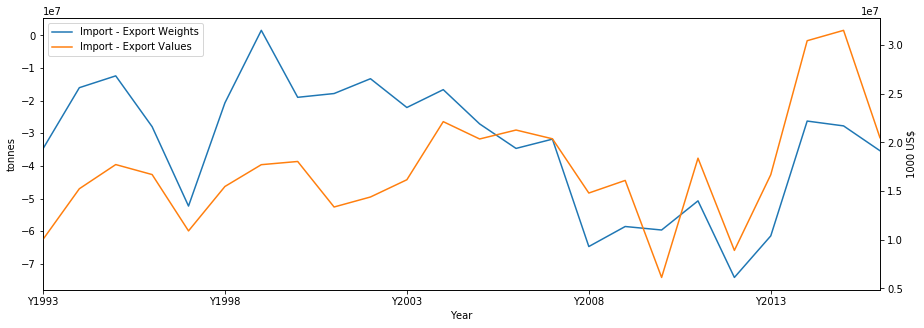

In [21]:
diff_w = import_w - export_w
diff_v = import_v - export_v

plot_trade(diff_w, diff_v, 'Import - Export')

We can see that every year, the amount of produce exported is greater than the amount of produce imported, but the value of imported produce is greater than the value of exported produce.

Many factors contribute to these disparities. The first, most obvious one is that trade isn't perfectly noted by all countries. Here are a few other reasons why these disparities exist:

* An export reported towards the end of a year might reach its destination in January and only be counted as an import the following year.
* Different countries report trade in different ways (e.g. some only count their own exports, while others count re-exports as exports).
* There can be missclassifications of different products between reporting countries.
* Exports can be lost during shipping (ships sinking, produce rotting, ...), and thus never be reported as imports.
* One of the trade partners might have keep data confidentiality and not report trades.
* There could be place of origin/final destination inconsistencies for 3 or more country trades. Example:
    * Switzerland imports Bananas from Colombia, but through the Netherlands.
    * Colombia reports exporting Bananas to Switzerland.
    * Switzerland reports importing Bananas from the Netherlands.
* Importers might try to evade customs tax, and misrepresent the amount or product imported, or simply not report it at all.
* Exports might not be declared to evade embargos.

As it's very inconveniant to have to seperate sets of values for trades, and there is no way of knowing which ones are correct, we decide to merge the df_trade matrix into a single set of trades, instead of having imports and exports.

For each value in the dataset, we take the true value to be the maximum of the import and export value. This leads us to probably overestimating the trade a little bit, but removes all errors that are due to missing values.

In [22]:
def clean_trade_quantities(df):
    """
    Merges the trade matrix using the max method.
    
    :param df: the trade matrix.
    :return: the merged matrices.
    """
    df_importer = df[df['Element'] == 'Import Quantity']
    df_exporter = df[df['Element'] == 'Export Quantity']
    # Trades as reported by the importing country
    df_importer = df_importer.rename(columns={
        'Reporter Countries': 'Importer',
        'Partner Countries': 'Exporter',
    }).drop(['Element', 'Unit'], axis=1)

    # Trades as reported by the exporting country
    df_exporter = df_exporter.rename(columns={
        'Reporter Countries': 'Exporter',
        'Partner Countries': 'Importer',
    }).drop(['Element', 'Unit'], axis=1)

    # Rename the columns
    cols_i = [name for name in df_importer.columns]
    cols_e = [name for name in df_exporter.columns]
    cols_i[3:] = [col + 'I' for col in cols_i[3:]]
    cols_e[3:] = [col + 'E' for col in cols_e[3:]]
    df_importer.columns = cols_i
    df_exporter.columns = cols_e

    # Merge the dataframes
    df_trades_m = df_importer.merge(df_exporter, how='outer', on=['Importer', 'Exporter', 'Item']).fillna(0)

    # Take the max of both types of reporter
    df_clean_trades = df_trades_m[['Importer', 'Exporter', 'Item']]
    df_importer_reports = df_trades_m[['Y' + str(year) + 'I' for year in range(1993, 2017)]]
    df_importer_reports.columns = [str(year) for year in range(1993, 2017)]
    df_exporter_reports = df_trades_m[['Y' + str(year) + 'E' for year in range(1993, 2017)]]
    df_exporter_reports.columns = [str(year) for year in range(1993, 2017)]
    max_values = df_importer_reports.where(df_importer_reports > df_exporter_reports, df_exporter_reports)
    df_clean_trades[[str(year) for year in range(1993, 2017)]] = max_values
    
    return df_clean_trades

In [23]:
df_trade = clean_trade_quantities(df_trade)

/Users/Niels/anaconda3/envs/ada/lib/python3.7/site-packages/pandas/core/frame.py:3494: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



We obtain the following result

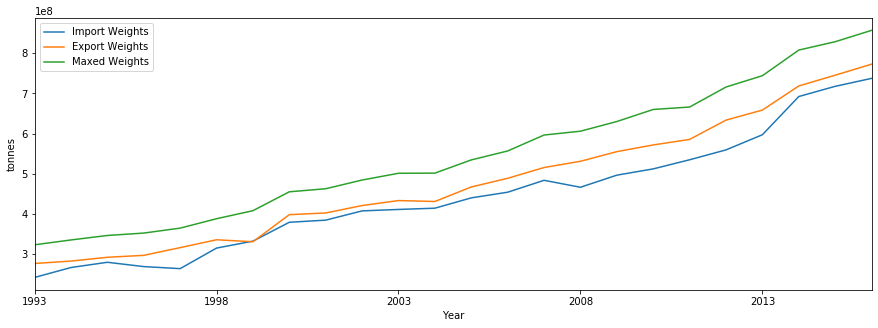

In [27]:
plt.figure(figsize=(15,5))
plt.xlabel('Year')
plt.ylabel('tonnes')
ax1 = import_w.plot(label='Import Weights')
ax2 = export_w.plot(label='Export Weights')
ax3 = df_trade[[f'{label}' for label in range(1993, 2017)]].sum(axis=0).plot(label='Maxed Weights')
plt.legend()
plt.show()

### 3.7.3 Intercontinental Trade

Now we want to see how continents trade with each other. We define for this the following continents

* Africa
* Americas
* Asia
* Europe
* Oceania

We used the FAO's data to seperate the countries in the matrix into continents.

http://www.fao.org/faostat/en/#definitions

We define inter-continental trades as any trade where the exporting country is in continent A and the importing country is in continent B, where A $\neq$ B. 

We define continental (or intra-continental) trade as any as any trade where the exporting country and the importing country are located in the same continent.

In [24]:
country_groups = pd.read_csv('data/FAOSTAT_data_11-19-2019.csv')
country_groups.head()

,Country Group Code,Country Group,Country Code,Country,M49 Code,ISO2 Code,ISO3 Code
0,5100,Africa,4,Algeria,12.0,DZ,DZA
1,5100,Africa,7,Angola,24.0,AO,AGO
2,5100,Africa,53,Benin,204.0,BJ,BEN
3,5100,Africa,20,Botswana,72.0,BW,BWA
4,5100,Africa,24,British Indian Ocean Territory,86.0,IO,IOT


In [25]:
african_countries = set(country_groups[country_groups['Country Group'] == 'Africa']['Country'])
american_countries = set(country_groups[country_groups['Country Group'] == 'Americas']['Country'])
asian_countries = set(country_groups[country_groups['Country Group'] == 'Asia']['Country'])
european_countries = set(country_groups[country_groups['Country Group'] == 'Europe']['Country'])
oceanian_countries = set(country_groups[country_groups['Country Group'] == 'Oceania']['Country'])

continents = [african_countries, american_countries, asian_countries, european_countries, oceanian_countries]
continent_names = ['Africa', 'Americas', 'Asia', 'Europe', 'Oceania']

We start by looking at how inter and intra continental has evolved between 1993 and 2016.

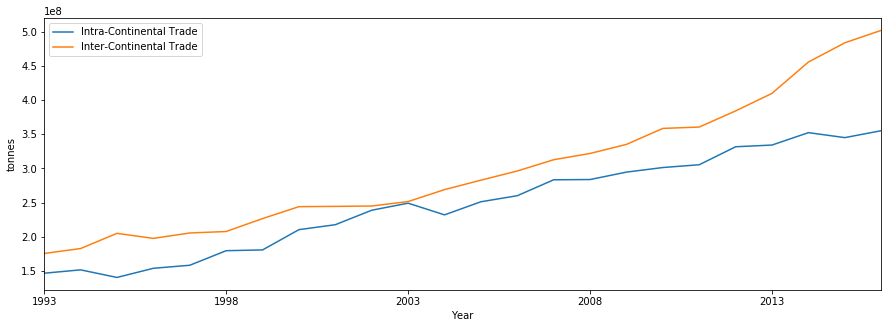

In [28]:
df_intra_cont_trade = pd.DataFrame(columns=df_trade.columns)
df_inter_cont_trade = pd.DataFrame(columns=df_trade.columns)

for c in continents:
    df_intra_cont_trade = df_intra_cont_trade.append(df_trade[(df_trade['Importer'].isin(c)) &
                                                              (df_trade['Exporter'].isin(c))])

for c1 in continents:
    for c2 in continents:
        if c1 != c2:
            df_inter_cont_trade = df_inter_cont_trade.append(df_trade[(df_trade['Importer'].isin(c1)) &
                                                                      (df_trade['Exporter'].isin(c2))])

df_intra_cont_trade_sums = df_intra_cont_trade[[str(label) for label in range(1993, 2017)]].sum(axis=0)
df_inter_cont_trade_sums = df_inter_cont_trade[[str(label) for label in range(1993, 2017)]].sum(axis=0)

plt.figure(figsize=(15,5))
plt.xlabel('Year')
plt.ylabel('tonnes')
df_intra_cont_trade_sums.plot(label='Intra-Continental Trade')
df_inter_cont_trade_sums.plot(label='Inter-Continental Trade')
plt.legend()
plt.show()

At first glance, their increase looks more or less similar. But these plots are on different scales. We hence look at what proportion of imports were from other continents, compared to the same continent.

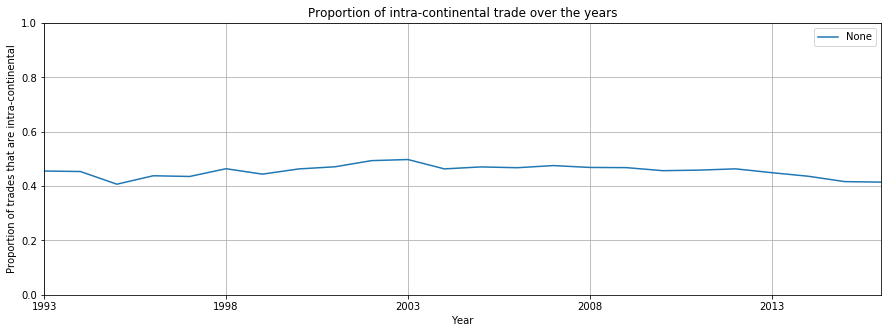

In [31]:
df_trade_sums = df_intra_cont_trade_sums + df_inter_cont_trade_sums

df_intra_cont_perc = df_intra_cont_trade_sums/df_trade_sums

plt.figure(figsize=(15,5))
plt.title('Proportion of intra-continental trade over the years')
plt.xlabel('Year')
plt.ylabel('Proportion of trades that are intra-continental')
df_intra_cont_perc.plot()
plt.ylim([0, 1])
plt.grid()
plt.legend()
plt.show()

We notice that there are only some very minor fluctuations, and this proportion stays very stable.

We now want to look more precisely at regions.

### 3.7.4 Inter-Regional Trade
Instead of considering continents, we consider the regions, as defined in the FAO's data:

* Africa
    * Eastern Africa
    * Middle Africa
    * Northern Africa
    * Southern Africa
    * Western Africa
* Americas
    * Northern America
    * Central America
    * Caribbean
    * South America
* Asia
    * Central Asia
    * Eastern Asia
    * Southern Asia
    * South-Eastern Asia
    * Western Asia
* Europe
    * Eastern Europe
    * Northern Europe
    * Southern Europe
    * Western Europe
* Oceania
    * Australia and New Zealand
    * Melanesia
    * Polynesia
    
We define inter-regional trades as any trade where the exporting country is in region A and the importing country is in region B, where A $\neq$ B. 

We define regional (or intra-regional) trade as any as any trade where the exporting country and the importing country are located in the same region.

In [32]:
region_names = ['Eastern Africa', 'Middle Africa', 'Northern Africa', 'Southern Africa', 'Western Africa',
                'Northern America', 'Central America', 'Caribbean', 'South America',
                'Central Asia', 'Eastern Asia', 'Southern Asia', 'South-Eastern Asia', 'Western Asia',
                'Eastern Europe', 'Northern Europe', 'Southern Europe', 'Western Europe',
                'Australia and New Zealand', 'Melanesia', 'Polynesia']
regions = [set(country_groups[country_groups['Country Group'] == region]['Country']) for region in region_names]

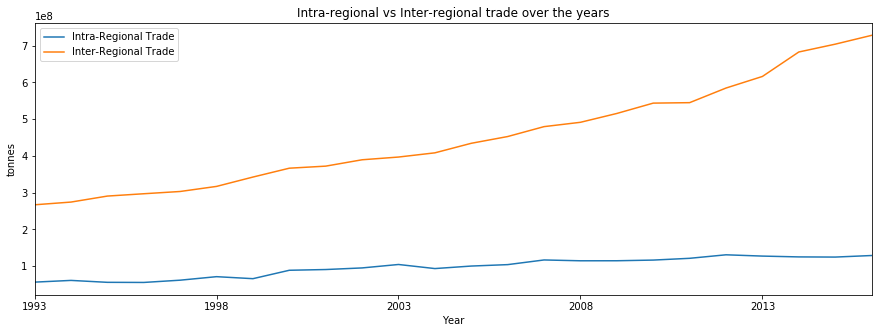

In [34]:
df_intra_reg_trade = pd.DataFrame(columns=df_trade.columns)
df_inter_reg_trade = pd.DataFrame(columns=df_trade.columns)

for r in regions:
    df_intra_reg_trade = df_intra_reg_trade.append(df_trade[(df_trade['Importer'].isin(r)) &
                                                              (df_trade['Exporter'].isin(r))])

for r1 in regions:
    for r2 in regions:
        if r1 != r2:
            df_inter_reg_trade = df_inter_reg_trade.append(df_trade[(df_trade['Importer'].isin(r1)) &
                                                                      (df_trade['Exporter'].isin(r2))])

df_intra_reg_trade_sums = df_intra_reg_trade[[str(label) for label in range(1993, 2017)]].sum(axis=0)
df_inter_reg_trade_sums = df_inter_reg_trade[[str(label) for label in range(1993, 2017)]].sum(axis=0)

plt.figure(figsize=(15,5))
plt.title('Intra-regional vs Inter-regional trade over the years')
plt.xlabel('Year')
plt.ylabel('tonnes')
df_intra_reg_trade_sums.plot(label='Intra-Regional Trade')
df_inter_reg_trade_sums.plot(label='Inter-Regional Trade')
plt.legend()
plt.show()

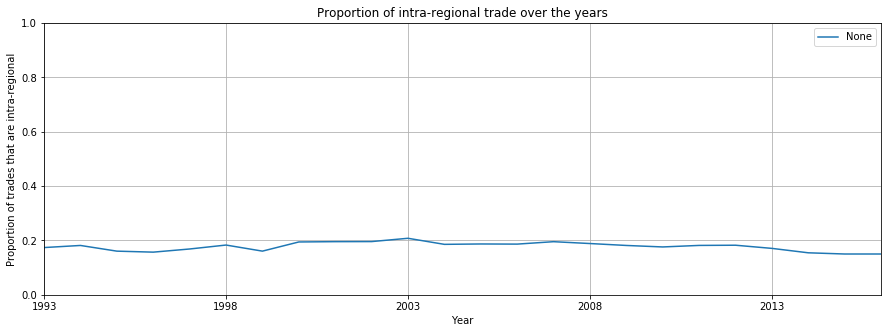

In [35]:
df_intra_reg_perc = df_intra_reg_trade_sums/df_trade_sums

plt.figure(figsize=(15,5))
plt.title('Proportion of intra-regional trade over the years')
plt.xlabel('Year')
plt.ylabel('Proportion of trades that are intra-regional')
df_intra_reg_perc.plot()
plt.ylim([0, 1])
plt.grid()
plt.legend()
plt.show()

As with intra-continental trade, this proportion stays quite stable as well. There is only a very slight dip at the end.  

In [41]:
#trimmed down production
df_prod.to_pickle("data/df_prod.pkl")
#trimmed down production value
df_value.to_pickle("data/df_value.pkl")
#trimmed down trade matrix ("Reporter","Partner","Item")
df_trade.to_pickle("data/df_trade.pkl")

## 4. Exploring similarities within countries

In this section we focus only on year 2016 and we study the similarities amongst the products produced, imported and exported between different countries, as well as the countries they trade with. As a measure of similarity we have used the Jaccard similarity and only 50 popular countries have been selected for easier visualization. The results are presented using heatmaps and grouping the countries based on the similarity (clustermap) for better comparisons. 
The next step of the project will be to include this results in a World-Map considering all countries and to extend them to different years.

In [42]:
# Countries selected
countries = ['Austria', 'Argentina', 'Belgium', 'Brazil', 'Bahamas', 'Canada','China, Hong Kong SAR', 'China, Taiwan Province of', 'China, mainland',  'Croatia','Cuba', 'Czechia',
       'Denmark', 'Dominica', 'Ecuador','Estonia','Finland','France', 'Germany', 'Greece', 'Hungary', 'Iceland', 'India','Ireland', 'Italy', 'Iran (Islamic Republic of)','Latvia', 'Lithuania',
       'Luxembourg', 'Malta', 'Morocco', 'Netherlands', 'Norway', 'Poland','Portugal','Republic of Moldova','Pakistan', 'Romania', 'Russian Federation', 'Slovakia', 'Slovenia',
       'Spain', 'Sweden', 'Switzerland','Turkey', 'Ukraine', 'United Arab Emirates','United Kingdom', 'United States of America']
df_countries = pd.DataFrame(countries)
df_countries.columns = ['Reporter Countries']

In [43]:
def jaccard_similarity(list1, list2):
    s1 = set(list1)
    s2 = set(list2)
    return len(s1.intersection(s2)) / len(s1.union(s2))

### 4.1. Similarity of products produced.

Each cell of the heatmap represents the similarity between each pair of countries considering the products they produce. We use the production matrix above saved. If we take a look i.e. at Switzerland, we find that it produces similar products as Austria, Germany, Poland and Canada. However, these clusters should be further analysis: Switzerland appears close to Russia, but the similarity is low. Belgium and France are also groupped separetdly but they have a high similarity with Switzerland. Spain, Turkey, Greeve and Italy also appear together.

We also plot the hierarchically-clustered heatmap. and now, we found Switzerland grouped with countries as

In [44]:
df_prod = pd.read_pickle("data/df_prod.pkl")
df_prod = df_prod.merge(df_countries, left_on = 'Area', right_on = 'Reporter Countries', how='inner')

(None, None)

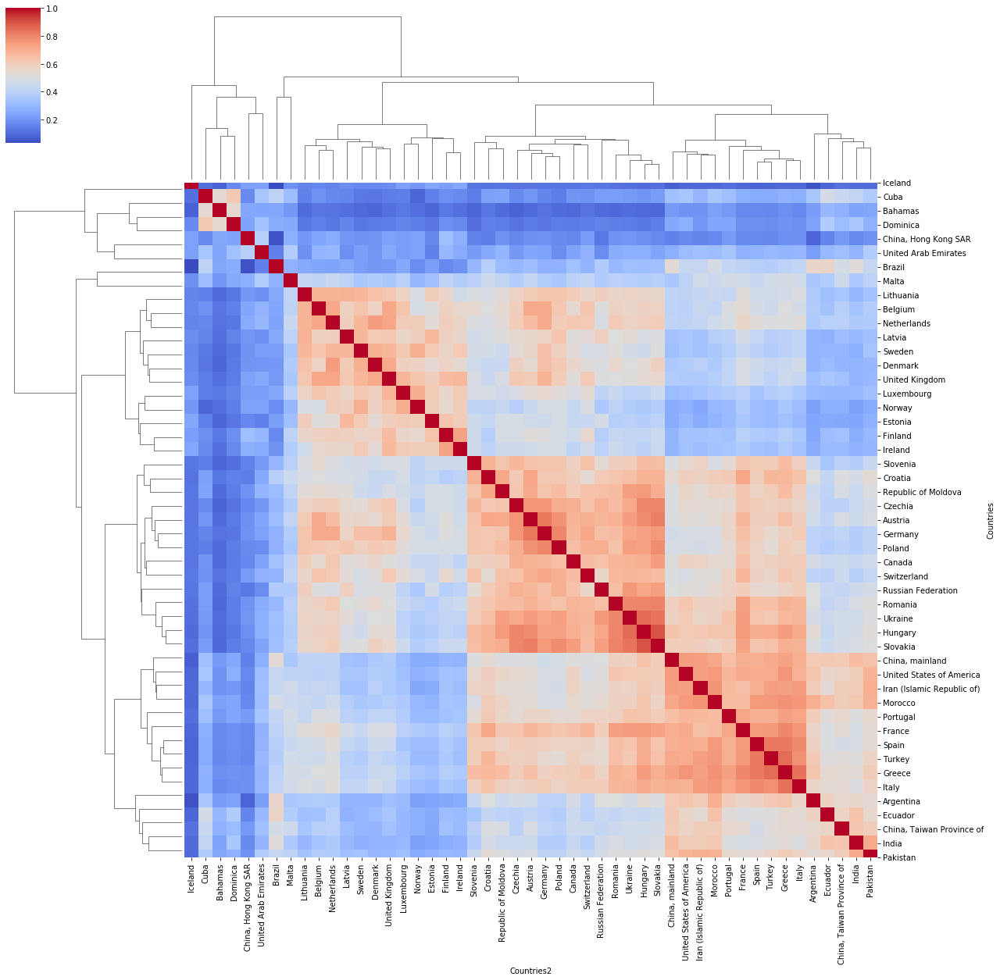

In [45]:
# Delete this items with 0 value of production
df_prod_simil = df_prod.loc[df_prod['Y2016'] != 0][['Area','Item','Y2016']].copy()
# We group by area, and list the items for each area
df_prod_simil = df_prod_simil.groupby('Area')['Item'].apply(list).reset_index(name='Collection Items')

# Compute Jaccard similarity
n = len(df_prod_simil)
labels = df_prod_simil['Area']
df_sim = pd.DataFrame(columns = ['Countries', 'Countries2', 'Similarity'])
for i in range(n):
    for j in range(n):
        list1 = df_prod_simil['Collection Items'].iloc[i]
        list2 = df_prod_simil['Collection Items'].iloc[j]
        a = jaccard_similarity(list1, list2)
        df_sim = df_sim.append({'Countries': labels[i], 'Countries2': labels[j], 'Similarity': a}, ignore_index=True)

df_pivot = df_sim.pivot('Countries', 'Countries2', 'Similarity')

clust = sns.clustermap(df_pivot, cmap='coolwarm', xticklabels=True, yticklabels=True)
clust.fig.set_figwidth(20), clust.fig.set_figheight(20)

### 4.2. Similarity of products imported.

Each cell of the heatmap represents the similarity within countries considering the products they import. The same approach has been used to study the products they export, but for simplicity they are not included here.

In [46]:
df_imp = pd.read_pickle("data/df_imp.pkl")
df_imp = df_imp.merge(df_countries, on = 'Reporter Countries', how='inner')

(None, None)

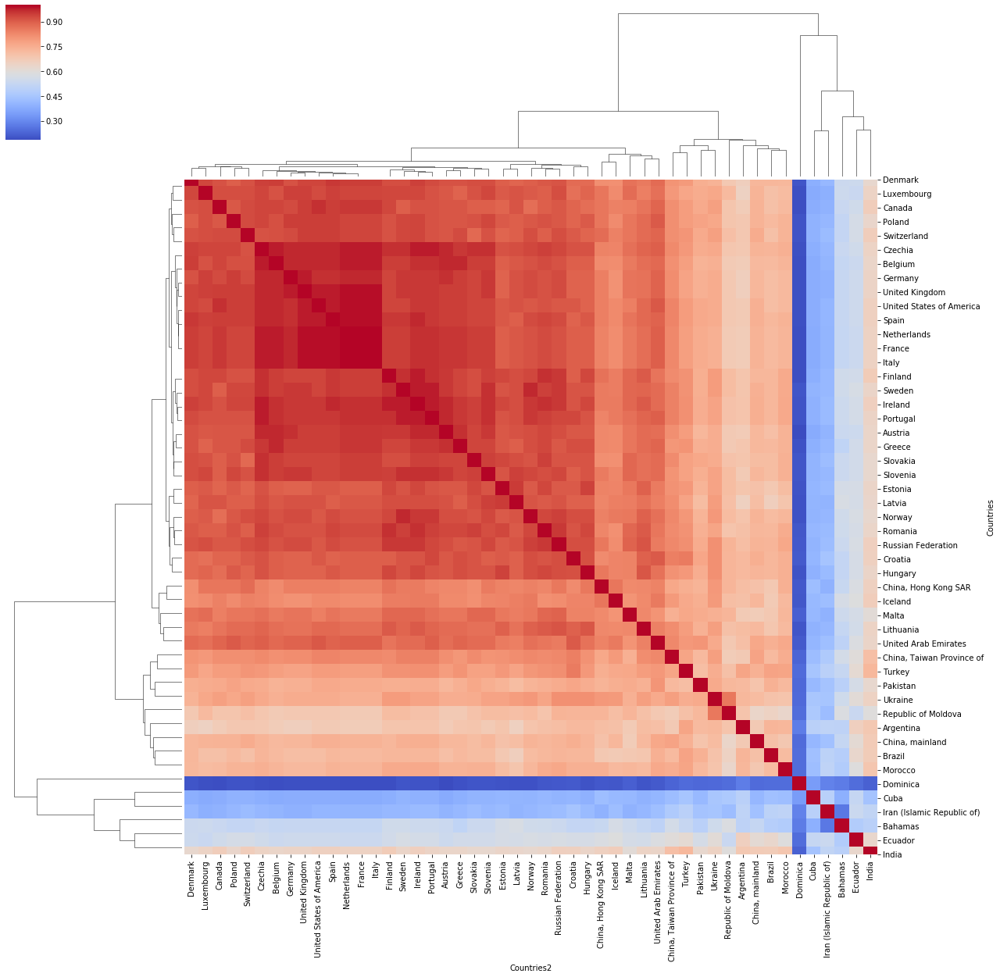

In [47]:
# Delete this items with 0 value of production
df_imp_simil_prod = df_imp.loc[df_imp['Y2016'] != 0][['Reporter Countries','Item','Y2016']].copy()
df_imp_simil_prod = df_imp_simil_prod.groupby('Reporter Countries')['Item'].apply(list).reset_index(name='Products Imported')

# Compute Jaccard similarity
n = len(df_imp_simil_prod)
labels = df_imp_simil_prod['Reporter Countries']
df_sim = pd.DataFrame(columns = ['Countries', 'Countries2', 'Similarity'])

for i in range(n):
    for j in range(n):
        list1 = df_imp_simil_prod['Products Imported'].iloc[i]
        list2 = df_imp_simil_prod['Products Imported'].iloc[j]
        a = jaccard_similarity(list1, list2)
        df_sim = df_sim.append({'Countries': labels[i], 'Countries2': labels[j], 'Similarity': a}, ignore_index=True)

df_pivot = df_sim.pivot('Countries', 'Countries2', 'Similarity')

clust = sns.clustermap(df_pivot, cmap='coolwarm', xticklabels=True, yticklabels=True)
clust.fig.set_figwidth(20), clust.fig.set_figheight(20)

### 4.3. Similarity of countries they import from

In this case, we consider the countries each country import from. Each cell of the heatmap represents the similarity considering these countries. The same results can be extended to exports. 

(None, None)

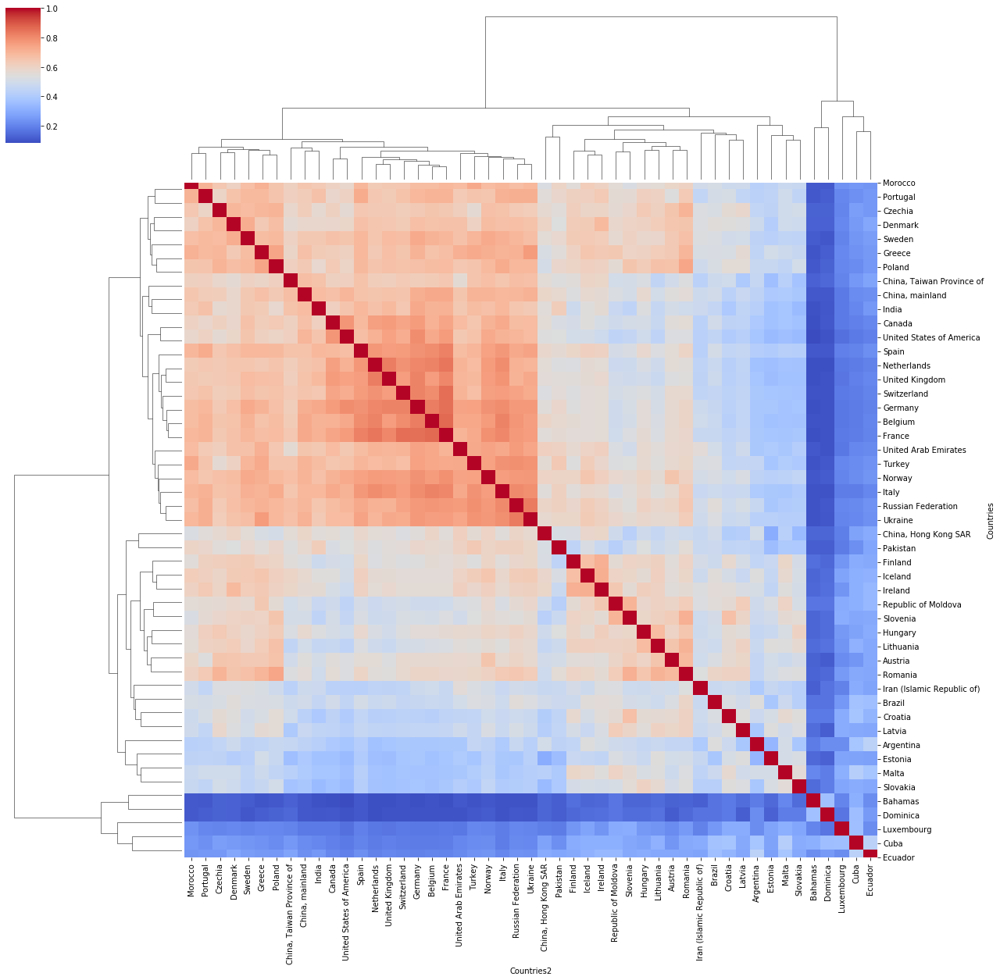

In [48]:
# Delete this items with 0 value of production
df_imp_simil = df_imp.loc[df_imp['Y2016'] != 0][['Reporter Countries','Partner Countries','Y2016']].copy()
df_imp_simil = df_imp_simil.groupby('Reporter Countries')['Partner Countries'].apply(list).reset_index(name='Partner Countries')

# Compute Jaccard similarity
n1 = len(df_imp_simil)
n2 = len(df_imp_simil)
labels = df_imp_simil['Reporter Countries']
df_sim = pd.DataFrame(columns = ['Countries', 'Countries2', 'Similarity'])

for i in range(n1):
    for j in range(n2):
        list1 = df_imp_simil['Partner Countries'].iloc[i]
        list2 = df_imp_simil['Partner Countries'].iloc[j]
        a = jaccard_similarity(list1, list2)
        df_sim = df_sim.append({'Countries': labels[i], 'Countries2': labels[j], 'Similarity': a}, ignore_index=True)

df_pivot = df_sim.pivot('Countries', 'Countries2', 'Similarity')
clust = sns.clustermap(df_pivot, cmap='coolwarm', xticklabels=True, yticklabels=True)
clust.fig.set_figwidth(20), clust.fig.set_figheight(20)

## 5. Exploring similarities within products

In this case we follow the same approach as before but grouping products considering the countries where they are produced. It could also be extended to where they are imported/exported. We select a subset of products. From the results it can be highlighted that tropical products as avocados, coconuts, pineapples, as well as coffe and tea are groupped together.

In [49]:
# Items selected
items = ['Almonds, with shell', 'Apples', 'Apricots', 'Grapes', 'Olives','Oranges', 'Peaches and nectarines', 'Pears',
       'Pistachios',  'Potatoes', 'Sesame seed','Sunflower seed', 'Vegetables, fresh nes','Watermelons', 'Wheat', 'Beans, green', 'Carrots and turnips','Cauliflowers and broccoli', 'Chillies and peppers, green',
       'Cucumbers and gherkins', 'Dates', 'Eggplants (aubergines)','Garlic', 'Lemons and limes', 'Lettuce and chicory','Mushrooms and truffles', 'Oats', 
       'Peas, green', 'Soybeans', 'Spinach','Tomatoes', 'Artichokes','Bananas', 'Chick peas', 'Chillies and peppers, dry','Lentils','Strawberries', 
       'Cocoa, beans', 'Coconuts', 'Pineapples','Cashew nuts, with shell', 'Coffee, green', 'Oil, palm','Sweet potatoes', 'Mangoes, mangosteens, guavas','Avocados', 'Papayas', 'Tea', 'Hazelnuts, with shell',
       'Blueberries','Kiwi fruit', 'Mustard seed','Plantains and others', 'Areca nuts',
       'Ginger', 'Jute', 'Pepper (piper spp.)','Quinoa','Cashewapple', 'Bambara beans', 'Cloves', 'Vanilla']

(None, None)

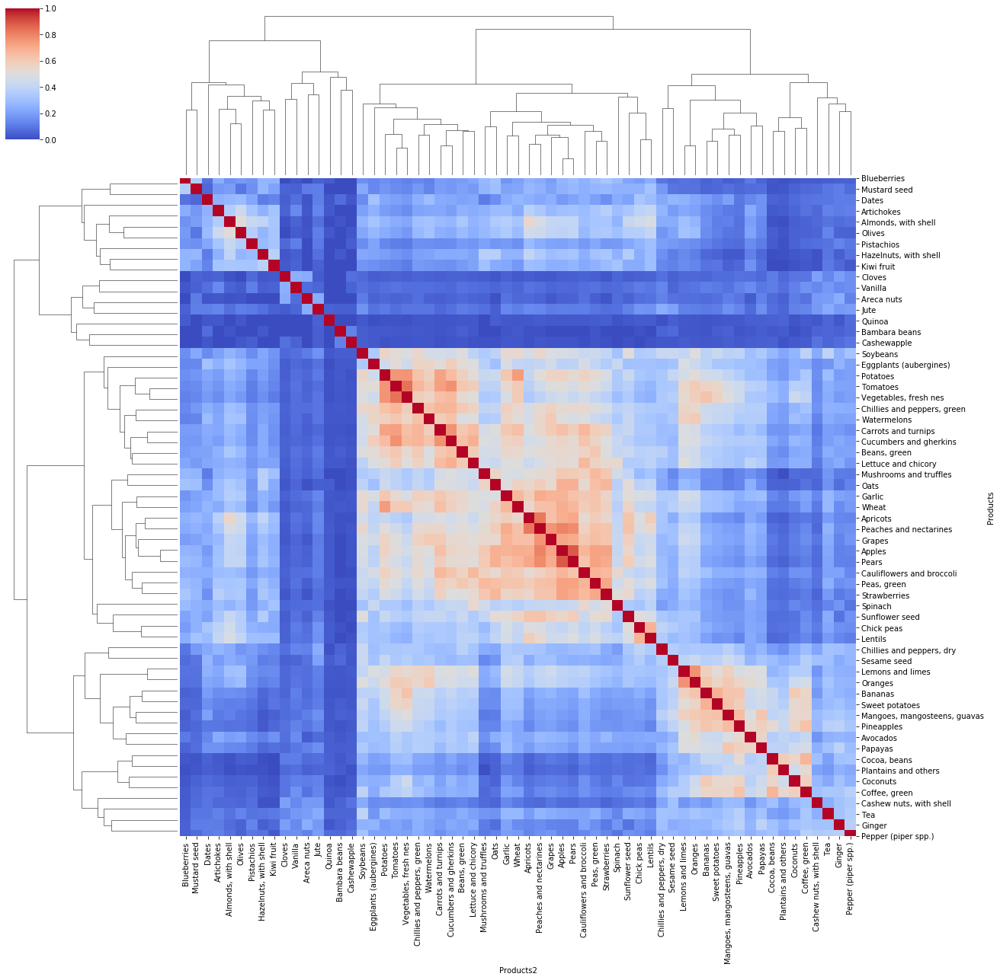

In [50]:
df_items = pd.DataFrame(items)
df_items.columns = ['Item']
df_prod = pd.read_pickle("data/df_prod.pkl")
df_prod = df_prod.merge(df_items, on = 'Item', how='inner')

# Delete this items with 0 value of production
df_area_simil = df_prod.loc[df_prod['Y2016'] != 0][['Area','Item','Y2016']].copy()
df_area_simil = df_area_simil.groupby('Item')['Area'].apply(list).reset_index(name='Areas production')

# Compute Jaccard similarity
n = len(df_area_simil)
labels = df_area_simil['Item']
df_sim = pd.DataFrame(columns = ['Products', 'Products2', 'Similarity'])

for i in range(n):
    for j in range(n):
        list1 = df_area_simil['Areas production'].iloc[i]
        list2 = df_area_simil['Areas production'].iloc[j]
        a = jaccard_similarity(list1, list2)
        df_sim = df_sim.append({'Products': labels[i], 'Products2': labels[j], 'Similarity': a}, ignore_index=True)

df_pivot = df_sim.pivot('Products', 'Products2', 'Similarity')
clust = sns.clustermap(df_pivot, cmap='coolwarm', xticklabels=True, yticklabels=True)
clust.fig.set_figwidth(20), clust.fig.set_figheight(20)

## 6. Data Story

Until Milestone 2, we were condisdering trades on a global scale. We explored the different trade trends worldwide, through which we noticed the increasing trade volumes. Moreover, we visaulized connections between countries and between items through heatmaps and clustering. This lead us to reflect on the data story that we wanted to construct, after which we decided to concentrate our efforts on identifying the effect of globalization on certain products.

This section is organized as follows:
- **6.1.** Global analysis.
- **6.2.** Soybeans
- **6.3.** Sesame seeds
- **6.4.** Avocados
- **6.5** Quinoa

### 6.1 Introduction: Global Trade Trends

  * Map imports/exports
  * Identify trade giants : China, Brazil, USA
  
First, we take a look again to how trade and production has increased. We also use the maps to visualize which countries have increased their imports, exports, and which are the main trade-lines amongst countries.

In [51]:
df_prod = pd.read_pickle("data/df_prod.pkl")
df_prod = df_prod.loc[df_prod['Element'] == 'Production'].drop(['Area','Item', 'Element', 'Unit'], axis = 1).dropna()
prod = np.array(df_prod).sum(axis = 0)
prod = prod

df_trade = pd.read_pickle('data/df_trade_merged.pkl')
df_trade = df_trade.drop(['Importer','Exporter', 'Item'], axis = 1).dropna()
trade = np.array(df_trade).sum(axis = 0)

from plotly.subplots import make_subplots
draft_template = go.layout.Template()
import plotly.graph_objects as go
years = ['1993', '1994', '1995', '1996', '1997', '1998', '1999', '2000', '2001', '2002', '2003', '2004', '2005', \
'2006', '2007', '2008', '2009', '2010', '2011', '2012', '2013', '2014', '2015', '2016'] 
fig = go.Figure()
fig = make_subplots(rows=1, cols=2, subplot_titles=("Production", "Trade"))

fig.add_trace(go.Scatter(x=years, y=prod, mode='lines', name='Production', line = dict(color='royalblue', width=4)), row=1, col=1)
fig.add_trace(go.Scatter(x=years, y=trade, mode='lines', name='Trade', line = dict(color='red', width=4)), row=1, col=2)
fig.update_layout(template=draft_template,
                   yaxis_title='Tonnes',
                  showlegend = False,
                 font=dict(
        family="roboto",
        size=12,
        color = 'rgb(0,0,0)'),
        width=800,
        height=400)
fig.update_xaxes(showline=True, linewidth=1, linecolor='black', showgrid = False)
fig.update_xaxes(title = 'Year', col = 1, row = 1)
fig.update_xaxes(title = 'Year', col = 2, row = 1)

In [52]:
from helpers import plot_imports
plot_imports(cs = 'speed')

In [53]:
from helpers import plot_exports
plot_exports(cs = 'speed')

In [54]:
from helpers import plot_globaltrade
# Set Europe to true if you want to merge the EU countries.
plot_globaltrade(Europe = True, cs = 'speed', thick = 12,  th_max = 1500, th_min = 1.5, th_max2 = 600, th_min2 = 1, op_per = 0.95)

### 6.2 Soy

**Plan:**
  * China imports/exports => notice that its most important product is soybeans
  * Brazil => becoming one of the biggest exporters of soybeans
    * Production and exports => dominance of soybeans agriculture
    * Plot area harvested, visualize with size of Switzerland

We have seen that China has become the largest importer of agricultural products in the world. But how exactly has China’s imports changed? Here is a look at total Chinese imports, exports and production between 1993 and 2016.

In [97]:
df_prod = pd.read_pickle('data/df_prod.pkl')
df_trade = pd.read_pickle('data/df_trade.pkl')

def rename_years(df):
    old_columns = ['Y' + str(y) for y in range(1993, 2017)]
    new_columns = [str(y) for y in range(1993, 2017)]
    return df.rename(columns=dict(zip(old_columns, new_columns)))
                         
df_china_import = df_trade[df_trade['Importer'] == 'China, mainland']
df_china_export = df_trade[df_trade['Exporter'] == 'China, mainland']
df_china_prod = rename_years(df_prod[(df_prod['Area'] == 'China, mainland') &
                                     (df_prod['Element'] == 'Production')])

def year_sums(df):
    df_years = df[[str(year) for year in range(1993, 2017)]]
    return df_years.sum(axis=0)

years = list(range(1993, 2017))
                         
df_china_import_sums = year_sums(df_china_import)
df_china_export_sums = year_sums(df_china_export)
df_china_prod_sums = year_sums(df_china_prod)

fig = go.Figure(
    data=[go.Scatter(x=years, y=df_china_import_sums.values, name='Imports', line_color="crimson"),
          go.Scatter(x=years, y=df_china_export_sums.values, name='Exports', line_color="blue"),
          go.Scatter(x=years, y=df_china_prod_sums.values, name='Production', line_color="green")],
)
fig.update_layout(
    xaxis_title="Year",
    yaxis_title="Value [tonnes]",
)
fig.show()

With production so much larger than imports and exports, we can't see much:

In [99]:
fig = go.Figure(
    data=[go.Scatter(x=years, y=df_china_import_sums.values, name='Imports', line_color="crimson"),
          go.Scatter(x=years, y=df_china_export_sums.values, name='Exports', line_color="blue")],
)
fig.update_layout(
    title="Chinese Agricultural Imports and Exports, in Tonnes",
    xaxis_title="Year",
    yaxis_title="Value [tonnes]"
)
fig.show()

As we can see Chinese imports skyrocket but their exports stay more or less stable. But what do they import?

In [100]:
def sort_2016(item):
    row = item[1]
    if row['2016']:
        return row['2016']
    else:
        return 0

rows = ['Item'] + [str(year) for year in range(1993, 2017)]
    
df_china_import_products = df_china_import[rows].groupby(by='Item').sum()

import_products = []
for index, row in df_china_import_products.iterrows():
    import_products.append((
        row.name,
        row
    ))

import_products.sort(key=sort_2016, reverse=True)


fig = go.Figure(
    data=[go.Scatter(x=years, y=import_products[0][1].values, name=import_products[0][0], line_color="crimson"),
          go.Scatter(x=years, y=import_products[1][1].values, name=import_products[1][0], line_color="blue"),
          go.Scatter(x=years, y=import_products[2][1].values, name=import_products[2][0], line_color="green"),
          go.Scatter(x=years, y=import_products[3][1].values, name=import_products[3][0], line_color="yellow"),
          go.Scatter(x=years, y=import_products[4][1].values, name=import_products[4][0], line_color="black")],
)
fig.update_layout(
    title="Top 5 Products Exported to China in 2016",
    xaxis_title="Year",
    yaxis_title="Value [tonnes]",
    width=1000,
    height=500,
)
fig.show()
fig.write_image("china_import_products.png")

They mostly import soy, and their total soybean imports have skyrocketed since 1993.

In [103]:
import plotly.express as px

draft_template= go.layout.Template()

def cond(row):
    return row == 'Soybeans'

df_china_import_soy = df_china_import_products.groupby(by=cond).sum()
df_china_import_soy = df_china_import_soy.reset_index().rename(columns={'index': 'Product'})
df_china_import_soy.iloc[0, 0] = 'Others'
df_china_import_soy.iloc[1, 0] = 'Soybeans'
df_china_import_soy = df_china_import_soy.set_index('Product')
df_import_stack = df_china_import_soy.stack().to_frame().reset_index()
df_import_stack = df_import_stack.rename(columns={'level_1': 'Year', 0: 'Quantity'})
df_import_stack.head()

fig = px.area(df_import_stack, x="Year", y="Quantity", color="Product", line_group="Product")

fig.update_layout(
    title="Soybeans Versus All Other Chinese Imports",
    xaxis_title="Year",
    yaxis_title="Tonnes",
    width=800,
    height=400,
    font=dict(
        family="source-serif-pro",
        size=14,
        color='rgb(0, 0, 0)',
    ),
    template=draft_template,
)

fig.update_xaxes(showgrid=False)

fig.show()

China stands out as the main importer of soybeans, but who's the main exporters of soybeans? It appears that the USA was the main source for a long time, but things have changed ever since the 1990s. Brazil started producing and exporting more.

In [55]:
df_prod = pd.read_pickle('data/df_prod.pkl')
df_prod.columns = ['Area', 'Item', 'Element', 'Unit'] + [str(year) for year in range(1993, 2017)] 
df_prod_brazil = df_prod.loc[df_prod['Area'] == 'Brazil']\
                        .loc[df_prod['Element'] == 'Production']\
                        .sort_values(['2016'], ascending=False)\
                        .reset_index()

df_trade = pd.read_pickle('data/df_trade_merged.pkl')
df_exports_brazil = df_trade.loc[df_trade['Exporter'] == 'Brazil']
df_exports_brazil = df_exports_brazil.groupby(['Exporter', 'Item']).sum().reset_index()
df_exports_brazil = df_exports_brazil.sort_values(['2016'], ascending = False).reset_index().drop(columns=['index'])

df_imports_brazil = df_trade.loc[df_trade['Importer'] == 'Brazil']
df_imports_brazil = df_imports_brazil.groupby(['Importer', 'Item']).sum().reset_index()
df_imports_brazil = df_imports_brazil.sort_values(['2016'], ascending = False).reset_index().drop(columns=['index'])

In [56]:
years = [str(year) for year in range(1993, 2017)] 
fig = go.Figure()
items = df_prod_brazil['Item']
for i in range(0, 10):
    fig.add_trace(go.Scatter(x=years, y= df_prod_brazil.iloc[i][years], mode='lines', name=items[i], line = dict(width=3)))
items = df_exports_brazil['Item']
for i in range(0, 10):
    fig.add_trace(go.Scatter(x=years, y=df_exports_brazil.iloc[i][years], mode='lines', name=items[i], line = dict(width=3), visible = False))
items = df_imports_brazil['Item']
for i in range(0, 10):
    fig.add_trace(go.Scatter(x=years, y=df_imports_brazil.iloc[i][years], mode='lines', name=items[i], line = dict(width=3), visible = False))

draft_template = go.layout.Template()
fig.update_layout(
    updatemenus=[
        go.layout.Updatemenu(
            active=0,
            x=0,
            y=1.2,
            buttons=list([
                dict(label="Production",
                     method="update",
                     args=[{"visible": [True, True, True, True, True, True, True, True, True, True,
                                        False, False, False, False, False, False, False, False, False, False,
                                       False, False, False, False, False, False, False, False, False, False]}]),
                dict(label="Exports",
                     method="update",
                     args=[{"visible": [False, False, False, False, False, False, False, False, False, False,
                                       True, True, True, True, True, True, True, True, True, True,
                                       False, False, False, False, False, False, False, False, False, False]}]),
                dict(label="Imports",
                     method="update",
                     args=[{"visible": [False, False, False, False, False, False, False, False, False, False,
                                       False, False, False, False, False, False, False, False, False, False,
                                       True, True, True, True, True, True, True, True, True, True]}]),
            ]),
        )
    ],
    template=draft_template,
    yaxis=dict(
        title='Tonnes',
        titlefont_size=14,
        tickfont_size=12,
    ),
    xaxis = dict(
      scaleratio = 1,
    ),
    title = 'Brazil production, exports and imports',
    width=800,
    height=500,
    font=dict(
        family="roboto",
        size=14,
        color = 'rgb(0,0,0)'
    )
)

We can see on these plots that Brazil has been promoting soybean agriculture, as the amount produced has more than quadrupled and the exports have skyrocketed. In the early 1990s, Brazil liberalized its trade regime and quickly established itself as one the main trade giants in the world.

Expanding trade regimes as well as increasing production and exports mean GDP growth, but at what cost? The soybean production need vast lands, and therfore we decided to look at the evolution of harvested area for soybeans in Brazil.

In [57]:
df_prod_area_brazil = df_prod.loc[df_prod['Area'] == 'Brazil']
df_prod_area_brazil = df_prod_area_brazil[df_prod_area_brazil['Element'] == 'Area harvested']\
                        .sort_values(['2016'], ascending=False)\
                        .reset_index()\
                        .drop(columns=['index'])

In [58]:
years = [str(year) for year in range(1993, 2017)] 
fig = go.Figure()
items = df_prod_area_brazil['Item']
fig.add_trace(go.Scatter(x=years, y= df_prod_area_brazil.iloc[0][years], mode='lines', name=items[0], line = dict(width=4)))
fig.update_layout(title='The evolution of the area harvested (in hectars) for soybeans in Brazil',
                  xaxis_title='Year',
                  yaxis_title='Area Harvested (in ha)',
                  template=draft_template,
                  width=600,
                  height=400,
                  font=dict(
                    family="roboto",
                    size=14,
                    color='rgb(0,0,0)'
                 ))

In [59]:
years = [str(year) for year in range(1993, 2017)] 
fig = go.Figure()
items = df_prod_area_brazil['Item']
fig.add_trace(go.Scatter(x=years, y= df_prod_area_brazil.iloc[0][years]/100/41285, mode='lines', name=items[0], line = dict(width=4)))
fig.update_layout(title='How many Switzerlands can we fit in the harvested area for soybeans in Brazil?',
                  xaxis_title='Year',
                  yaxis_title='Number of Switzerlands',
                  template=draft_template,
                  width=600,
                  height=400,
                  font=dict(
                    family="roboto",
                    size=14,
                    color='rgb(0,0,0)'
                 ))

The harvested area tripled in size between 1993 and 2016.

### 6.3. Sesame seeds

We analyze their production and how they are trade.

In [60]:
from helpers import production_trade
production_trade('Soybeans', Europe = True, cs = 'speed', thick = 12,  th_max = 330, th_min = 2, th_max2 = 120, th_min2 = 1, op_per = 0.95)

### 6.4. Avocados

We start by analyzing the the increase in trade and production, as well as how they are traded and the main producers by looking to the map.

In [61]:
df_prod = pd.read_pickle("data/df_prod.pkl")
df_prod = df_prod.loc[df_prod['Element'] == 'Production']
df_prod = df_prod.loc[df_prod['Item'] == 'Avocados'].drop(['Area','Item', 'Element', 'Unit'], axis = 1).dropna()
prod = np.array(df_prod).sum(axis = 0)
prod = prod

df_trade = pd.read_pickle('data/df_trade_merged.pkl')
df_trade = df_trade.loc[df_trade['Item'] == 'Avocados']
df_trade = df_trade.drop(['Importer','Exporter', 'Item'], axis = 1).dropna()
trade = np.array(df_trade).sum(axis = 0)
trade = trade

import plotly.graph_objects as go
years = ['1993', '1994', '1995', '1996', '1997', '1998', '1999', '2000', '2001', '2002', '2003', '2004', '2005', \
'2006', '2007', '2008', '2009', '2010', '2011', '2012', '2013', '2014', '2015', '2016'] 
fig = go.Figure()
fig.add_trace(go.Scatter(x=years, y=prod, mode='lines', name='Production', line = dict(color='royalblue', width=4)))
fig.add_trace(go.Scatter(x=years, y=trade, mode='lines', name='Trade', line = dict(color='red', width=4)))
fig.update_layout(title='Production and trade',
                   xaxis_title='Year',
                   yaxis_title='Increase fold from 1993')

In [62]:
from helpers import production_trade
# Set Europe to False if you want to see the EU countries individually
production_trade('Avocados', Europe = True, cs = 'speed', thick = 15,  th_max = 320, th_min = 2, th_max2 = 120, th_min2 = 1, op_per = 0.95)

### Getting numbers:

**a) Mexico-US:**

In [63]:
df_prod = pd.read_pickle("data/df_prod.pkl")
df_prod = df_prod.loc[df_prod['Element'] == 'Production']
df_prod = df_prod.loc[df_prod['Item'] == 'Avocados']

df_trade = pd.read_pickle('data/df_trade.pkl')
df_trade = df_trade.loc[df_trade['Item'] == 'Avocados']

In [64]:
trade_16 = df_trade.loc[df_trade['Exporter'] == 'Mexico']
mexico_total_exp_16 = np.sum(trade_16['2016'])
mexico_total_exp_94 = np.sum(trade_16['1994'])
print(f'Total exports of Avocados of Mexico in 1994: {mexico_total_exp_94}, and in 2016: {mexico_total_exp_16}') 

Total exports of Avocados of Mexico in 1994: 41175.0, and in 2016: 1033664.0


In [65]:
mexico_US_exp_16 = trade_16.loc[df_trade['Importer'] == 'United States of America']['2016'].sum()
mexico_US_exp_94 = trade_16.loc[df_trade['Importer'] == 'United States of America']['1994'].sum()
print(f'Total exports of to the US in 1994: {mexico_US_exp_94}, and in 2016: {mexico_US_exp_16}')

Total exports of to the US in 1994: 5751.0, and in 2016: 785076.0


In [66]:
ratio_94 = mexico_US_exp_94/mexico_total_exp_94
ratio_16 = mexico_US_exp_16/mexico_total_exp_16
print(f'Ratio of exports to the US in 1994: {ratio_94}, and in 2016: {ratio_16}')

Ratio of exports to the US in 1994: 0.13967213114754098, and in 2016: 0.7595079252058696


In [67]:
prod_16 = df_prod.loc[df_prod['Area'] == 'Mexico']['Y2016'].sum()
prod_94 = df_prod.loc[df_prod['Area'] == 'Mexico']['Y1994'].sum()
print(f'Total production of avocados in 1994: {prod_94}, and in 2016: {prod_16}')

Total production of avocados in 1994: 799929.0, and in 2016: 1889354.0


**b) EUROPE**

In [68]:
from GRANADA import correct_names
correct3 =  ['EU','EU','EU','EU','EU','EU','EU','EU','EU','EU','EU','EU','EU','EU','EU','EU','EU',
          'EU','EU','EU','EU','EU','EU','EU','EU','EU','EU', 'EU']
wrong3 = ['Austria', 'Belgium', 'Bulgaria', 'Croatia', 'Czechia', 'Denmark', 'Estonia', 'Finland', 'France', 'Germany',  'Greece', 'Hungary', 'Ireland', 'Italy', 'Latvia', 'Lithuania', 'Luxembourg', 'Malta', 'Netherlands', 'Poland',
     'Portugal', 'Romania', 'Slovakia',  'Slovenia', 'Spain', 'Sweden', 'United Kingdom', 'Cyprus']

Analizing the main importers and exporters to the EU:

In [69]:
trade_toEU = correct_names(df_trade, 'Importer', correct3, wrong3)
trade_toEU = correct_names(trade_toEU, 'Exporter', correct3, wrong3)
trade_toEU = trade_toEU.groupby(['Importer', 'Exporter']).sum().reset_index()
trade_toEU.loc[trade_toEU['Importer'] == 'EU'].sort_values(['1994'], ascending = False).head()

,Importer,Exporter,1993,1994,1995,1996,1997,1998,1999,2000,...,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016
640,EU,EU,53870.0,55508.0,58523.0,76698.0,78657.0,96367.0,76953.0,92597.0,...,135769.0,163136.0,156879.0,188142.0,199587.0,214195.0,229493.0,255217.0,294944.0,366331.0
708,EU,South Africa,19027.0,34728.0,15875.0,10784.0,14846.0,38430.0,30300.0,56647.0,...,39952.0,55179.0,46689.0,51076.0,32829.0,53453.0,48610.0,66307.0,56429.0,60205.0
660,EU,Israel,24311.0,22013.0,30284.0,42344.0,39283.0,26792.0,39449.0,58248.0,...,69233.0,34284.0,38109.0,48188.0,44241.0,39184.0,47084.0,45485.0,44281.0,39089.0
676,EU,Mexico,13733.0,21039.0,36454.0,27698.0,19170.0,14201.0,14442.0,13802.0,...,11900.0,12377.0,10818.0,8176.0,3624.0,5945.0,9599.0,12267.0,27793.0,56566.0
665,EU,Kenya,5966.0,6745.0,8743.0,6419.0,12501.0,6945.0,9659.0,11442.0,...,11871.0,11847.0,15046.0,14136.0,15034.0,17079.0,17518.0,15605.0,20803.0,23535.0


In [70]:
trade_toEU.loc[trade_toEU['Importer'] == 'EU'].sort_values(['2016'], ascending = False).head(5)

,Importer,Exporter,1993,1994,1995,1996,1997,1998,1999,2000,...,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016
640,EU,EU,53870.0,55508.0,58523.0,76698.0,78657.0,96367.0,76953.0,92597.0,...,135769.0,163136.0,156879.0,188142.0,199587.0,214195.0,229493.0,255217.0,294944.0,366331.0
690,EU,Peru,0.0,0.0,0.0,3.0,3.0,4.0,486.0,2376.0,...,42895.0,60207.0,54223.0,64837.0,80091.0,75556.0,98283.0,119324.0,128828.0,159287.0
628,EU,Chile,2905.0,31.0,12.0,23.0,2.0,26.0,4.0,50.0,...,32734.0,18721.0,46289.0,37339.0,29918.0,46118.0,58869.0,62569.0,69687.0,97402.0
708,EU,South Africa,19027.0,34728.0,15875.0,10784.0,14846.0,38430.0,30300.0,56647.0,...,39952.0,55179.0,46689.0,51076.0,32829.0,53453.0,48610.0,66307.0,56429.0,60205.0
676,EU,Mexico,13733.0,21039.0,36454.0,27698.0,19170.0,14201.0,14442.0,13802.0,...,11900.0,12377.0,10818.0,8176.0,3624.0,5945.0,9599.0,12267.0,27793.0,56566.0


Analyzing the Netherlands, since they appear as the 3rd most important exporters.

In [79]:
df_trade = pd.read_pickle('data/df_trade.pkl')
df_trade = df_trade.loc[df_trade['Item'] == 'Avocados']

In [80]:
df_trade.groupby(['Exporter']).sum().sort_values(['2016'], ascending = False).head(5)

,1993,1994,1995,1996,1997,1998,1999,2000,2001,2002,...,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016
Exporter,,,,,,,,,,,,,,,,,,,,,
Mexico,23487.0,41175.0,68260.0,49122.0,63848.0,73235.0,67983.0,110623.0,89831.0,103384.0,...,312746.0,315463.0,391870.0,369352.0,403940.0,565010.0,654237.0,755191.0,1001018.0,1033664.0
Peru,77.0,0.0,0.0,3.0,3.0,4.0,594.0,2885.0,2634.0,5628.0,...,48314.0,69408.0,65078.0,76539.0,99852.0,107264.0,135808.0,209961.0,203788.0,223968.0
Netherlands,6274.0,8510.0,13603.0,18392.0,16127.0,18259.0,17050.0,18211.0,19594.0,20943.0,...,55881.0,67801.0,74138.0,80420.0,88023.0,111188.0,126684.0,136293.0,153721.0,200089.0
Chile,5083.0,18774.0,11924.0,16789.0,16717.0,48226.0,37720.0,56846.0,57955.0,81221.0,...,151190.0,88413.0,172956.0,116039.0,110368.0,103268.0,98195.0,128985.0,108787.0,171249.0
Spain,36635.0,29882.0,25038.0,37995.0,45038.0,58012.0,41090.0,42758.0,45550.0,45141.0,...,50480.0,60142.0,53843.0,60499.0,79646.0,75586.0,78824.0,83408.0,95913.0,101146.0


In [81]:
netherlands = df_trade.loc[df_trade['Exporter'] == 'Netherlands']
netherlands = netherlands.loc[netherlands['2016'] != 0]
netherlands.sort_values(['2016'], ascending = False).head()

,Importer,Exporter,Item,1993,1994,1995,1996,1997,1998,1999,...,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016
122793,Germany,Netherlands,Avocados,2313.0,4918.0,4400.0,5658.0,5449.0,5562.0,5859.0,...,11491.0,12255.0,13395.0,17429.0,20298.0,24155.0,25446.0,30202.0,38403.0,57025.0
111123,France,Netherlands,Avocados,1333.0,771.0,3286.0,4653.0,3291.0,4041.0,3235.0,...,9626.0,13523.0,17124.0,12942.0,11491.0,16425.0,22806.0,19036.0,18697.0,21178.0
303472,Sweden,Netherlands,Avocados,518.0,397.0,2648.0,3622.0,3196.0,4096.0,2715.0,...,8234.0,8465.0,9068.0,12028.0,15089.0,17978.0,18459.0,16365.0,14612.0,16038.0
334818,United Kingdom,Netherlands,Avocados,442.0,344.0,211.0,509.0,306.0,336.0,667.0,...,4432.0,6762.0,6549.0,3861.0,5223.0,6422.0,7955.0,7542.0,10733.0,14580.0
89971,Denmark,Netherlands,Avocados,625.0,1037.0,946.0,1261.0,1133.0,1250.0,1358.0,...,3862.0,6295.0,6954.0,8834.0,9089.0,9569.0,9265.0,9460.0,11593.0,12916.0


In [82]:
total_exp = np.sum(netherlands['2016'])
exp_germany = np.sum(netherlands.loc[netherlands['Importer'] == 'Germany']['2016'])
print(f'Total exports of the Netherlands: {total_exp}, exports to germany: {exp_germany}, percentage: {exp_germany*100/total_exp}')
exp_france = np.sum(netherlands.loc[netherlands['Importer'] == 'France']['2016'])
print(f'Total exports of the Netherlands: {total_exp}, exports to france: {exp_france}, percentage: {exp_france*100/total_exp}')

Total exports of the Netherlands: 200089.0, exports to germany: 57025.0, percentage: 28.499817581176377
Total exports of the Netherlands: 200089.0, exports to france: 21178.0, percentage: 10.584289990954025


### 6.5. Quinoa

We analyze the map to see the way is traded and the main producers.

In [83]:
from GRANADA import production_trade
# Set Europe to False if you want to see the EU countries individually
production_trade('Quinoa', Europe = True, cs = 'speed', thick = 12,  th_max = 250, th_min = 2, th_max2 = 120, th_min2 = 1, op_per = 0.95)

{'data': [{'type': 'choropleth', 'locations': 3717     Bolivia
   10501    Ecuador
   25509       Peru
   Name: Area, dtype: object, 'z': 3717     19129.0
   10501      493.0
   25509    17157.0
   Name: Y1993, dtype: float64, 'hoverinfo': 'text', 'hovertext': 3717     Bolivia: 19129.0 Tonnes
   10501      Ecuador: 493.0 Tonnes
   25509       Peru: 17157.0 Tonnes
   dtype: object, 'colorscale': 'speed', 'colorbar_title': 'Production (Tonnes)', 'zmax': 79269.0, 'zmin': 493.0, 'locationmode': 'country names'},
  {'type': 'scattergeo',
   'locationmode': 'country names',
   'lon': [-102.42, -64.68538645],
   'lat': [38.75, -16.70814787],
   'hoverinfo': 'skip',
   'mode': 'lines',
   'visible': False,
   'line': {'width': 1.051640297329845, 'color': 'red'},
   'opacity': 1.0},
  {'type': 'scattergeo',
   'locationmode': 'country names',
   'lon': [-102.42],
   'lat': [38.75],
   'hoverinfo': 'text',
   'text': 'Import: 245 Tonnes',
   'mode': 'markers',
   'visible': False,
   'marker': {

Analyzing the main importers and exporters:

In [84]:
# 10 most relevant exporters in 2016
info_imp = df_trade.groupby(['Importer']).sum().reset_index()[['Importer', '2012', '2014', '2016']]
plot_imp = info_imp.sort_values(['2016'], ascending = False).iloc[:10]
# 10 most relevant exporter in 2016
info_exp = df_trade.groupby(['Exporter']).sum().reset_index()[['Exporter', '2012', '2014', '2016']]
plot_exp = info_exp.sort_values(['2016'], ascending = False).iloc[:10]
from helpers import correct_names
plot_exp = correct_names(plot_exp, 'Exporter', ['Bolivia', 'U.S.', 'U.K.'], ['Bolivia (Plurinational State of)', 'United States of America', 'United Kingdom'])
plot_imp = correct_names(plot_imp, 'Importer', ['Bolivia', 'U.S.', 'U.K.'], ['Bolivia (Plurinational State of)', 'United States of America', 'United Kingdom'])

In [85]:
import plotly.graph_objects as go
fig = go.Figure(data=[
    go.Bar(name='2012', x=plot_exp['Exporter'], y=plot_exp['2012'], marker_color = 'wheat'),
    go.Bar(name='2014', x=plot_exp['Exporter'], y=plot_exp['2014'], marker_color='lightsalmon'),
    go.Bar(name='2016', x=plot_exp['Exporter'], y=plot_exp['2016'], marker_color='indianred'),
    go.Bar(name='2012', x=plot_imp['Importer'], y=plot_imp['2012'], marker_color = 'wheat', visible = False),
    go.Bar(name='2014', x=plot_imp['Importer'], y=plot_imp['2014'], marker_color='lightsalmon', visible = False),
    go.Bar(name='2016', x=plot_imp['Importer'], y=plot_imp['2016'], marker_color='indianred', visible = False),
])

fig.update_layout(
    updatemenus=[
        go.layout.Updatemenu(
            y = 1.2,
            active=0,
            buttons=list([
                dict(label="Exports",
                     method="update",
                     args=[{"visible": [True, True, True, False, False, False]},
                          {"title": "Top-10 Quinoa Exporters"}]),
                dict(label="Imports",
                     method="update",
                     args=[{"visible": [False, False, False, True, True, True]},
                          {"title": "Top-10 Quinoa Importers"}]),
            ]),
        )
    ],
    template=draft_template,
    yaxis=dict(
        title='Tonnes',
        titlefont_size=13,
        tickfont_size=12,
    ),
    width=800,
    height=500,
    title = 'Quinoa',
    font=dict(
        family="roboto",
        size=14,
        color = 'rgb(0,0,0)'
    ),
   
    #paper_bgcolor='rgba(0,0,0,0)',
)
fig.update_layout(barmode='group', xaxis_tickangle=45)
#plotly.offline.plot(fig, filename='top10Quinoa.html')

Analyzing **Peru**: we check how the production, the area used for it and the ratio of are used for quinoa has increased.

In [86]:
prod_peru = df_prod.loc[df_prod['Area'] == 'Peru']
prod_peru

,Area,Item,Element,Unit,Y1993,Y1994,Y1995,Y1996,Y1997,Y1998,...,Y2007,Y2008,Y2009,Y2010,Y2011,Y2012,Y2013,Y2014,Y2015,Y2016
25302,Peru,Avocados,Production,tonnes,92658.0,53112.0,53145.0,64408.0,72093.0,67222.0,...,121720.0,136303.0,157415.0,184370.0,213662.0,268525.0,288387.0,349317.0,367110.0,455394.0


In [87]:
trade_peru = df_trade.loc[df_trade['Exporter'] == 'Peru']
years = ['1993', '1994', '1995', '1996', '1997', '1998', '1999', '2000', '2001', '2002', '2003', 
        '2004', '2005', '2006', '2007', '2008', '2009', '2010', '2011', '2012', '2013', '2014', 
        '2015', '2016']
sum_trade_peru = trade_peru[years].sum()
sum_exp = np.array(sum_trade_peru)
sum_exp

array([7.70000e+01, 0.00000e+00, 0.00000e+00, 3.00000e+00, 3.00000e+00,
       4.00000e+00, 5.94000e+02, 2.88500e+03, 2.63400e+03, 5.62800e+03,
       1.26370e+04, 1.56510e+04, 2.28780e+04, 3.90040e+04, 4.83140e+04,
       6.94080e+04, 6.50780e+04, 7.65390e+04, 9.98520e+04, 1.07264e+05,
       1.35808e+05, 2.09961e+05, 2.03788e+05, 2.23968e+05])

In [88]:
# Area for Quinoa
df_prod = pd.read_pickle("data/df_prod.pkl")
df_area = df_prod.loc[df_prod['Element'] == 'Area harvested']
df_area = df_area.loc[df_area['Area'] == 'Peru']

area_quinoa = df_area.loc[df_area['Item'] == 'Quinoa']
area_quinoa_np = area_quinoa.iloc[:,4:].values[0]
area_quinoa_np

array([17812., 20693., 18729., 18704., 27033., 30720., 28979., 28889.,
       25601., 27851., 28326., 27676., 28632., 29947., 30381., 31163.,
       34026., 35313., 35475., 38495., 44868., 68140., 69303., 64223.])

In [89]:
# Total area cultivated
total_area = df_area.iloc[:,4:].sum()
total_area.values

array([1406973., 1464560., 1584187., 1727937., 1798263., 1925292.,
       1987718., 2196585., 2117635., 2135298., 2142458., 2079323.,
       2171590., 2248345., 2288203., 2372421., 2448064., 2471180.,
       2436107., 2534192., 2672644., 2587863., 2657884., 2568675.])

In [90]:
# Ratio of Area used for quinoa
area_quinoa_np/total_area.values

array([0.0126598 , 0.01412916, 0.01182247, 0.01082447, 0.01503284,
       0.01595602, 0.01457903, 0.01315178, 0.01208943, 0.01304314,
       0.01322126, 0.0133101 , 0.01318481, 0.01331958, 0.01327723,
       0.01313553, 0.01389915, 0.01428993, 0.01456217, 0.01519025,
       0.01678787, 0.02633061, 0.0260745 , 0.02500238])

Finally we check again the countries that the Netherlands export to, since it appears as one of the main exporters. They seem to be one of the main redistributers.

In [91]:
df_trade.loc[df_trade['Exporter'] == 'Netherlands'].sort_values(['2016'], ascending = False).head(10)

,Importer,Exporter,Item,1993,1994,1995,1996,1997,1998,1999,...,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016
122793,Germany,Netherlands,Avocados,2313.0,4918.0,4400.0,5658.0,5449.0,5562.0,5859.0,...,11491.0,12255.0,13395.0,17429.0,20298.0,24155.0,25446.0,30202.0,38403.0,57025.0
111123,France,Netherlands,Avocados,1333.0,771.0,3286.0,4653.0,3291.0,4041.0,3235.0,...,9626.0,13523.0,17124.0,12942.0,11491.0,16425.0,22806.0,19036.0,18697.0,21178.0
303472,Sweden,Netherlands,Avocados,518.0,397.0,2648.0,3622.0,3196.0,4096.0,2715.0,...,8234.0,8465.0,9068.0,12028.0,15089.0,17978.0,18459.0,16365.0,14612.0,16038.0
334818,United Kingdom,Netherlands,Avocados,442.0,344.0,211.0,509.0,306.0,336.0,667.0,...,4432.0,6762.0,6549.0,3861.0,5223.0,6422.0,7955.0,7542.0,10733.0,14580.0
89971,Denmark,Netherlands,Avocados,625.0,1037.0,946.0,1261.0,1133.0,1250.0,1358.0,...,3862.0,6295.0,6954.0,8834.0,9089.0,9569.0,9265.0,9460.0,11593.0,12916.0
225680,Norway,Netherlands,Avocados,135.0,61.0,167.0,361.0,177.0,20.0,263.0,...,2920.0,3535.0,3817.0,4610.0,6429.0,7216.0,8173.0,9796.0,10875.0,12463.0
296130,Spain,Netherlands,Avocados,102.0,326.0,401.0,243.0,34.0,242.0,202.0,...,1173.0,1268.0,1308.0,1203.0,869.0,4462.0,5791.0,5981.0,5492.0,8872.0
309388,Switzerland,Netherlands,Avocados,118.0,55.0,197.0,126.0,131.0,185.0,186.0,...,1646.0,1988.0,1935.0,2145.0,2224.0,2722.0,3084.0,4013.0,7273.0,8156.0
31193,Belgium,Netherlands,Avocados,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,2268.0,2375.0,2511.0,2084.0,2104.0,3619.0,3731.0,4323.0,4853.0,7913.0
157080,Italy,Netherlands,Avocados,90.0,79.0,40.0,67.0,115.0,164.0,112.0,...,604.0,509.0,702.0,1259.0,1536.0,2526.0,2330.0,3847.0,5071.0,6380.0
